# Things covered.

* creating custom dataset for detectron2
* training model on custom dataset
* creating custom trainer and hooks to customize training (print validation loss, save best model, run model evaluation).
* exporting caffe2 model

# Install detectron2 and download wgist grape dataset

We'll install detectron2 and its dependencies, We'll also download wgisd grape dataset.

In [ ]:
!pip install pyyaml==5.1
!pip install onnx
!pip install 'git+https://github.com/facebookresearch/detectron2.git'
!git clone https://github.com/thsant/wgisd

     |████████████████████████████████| 276kB 17.2MB/s eta 0:00:01
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=74e935d31a34782505781fe41ba76aa5b413010c711d5e89f3fc3591c6dccb02
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 14.5MB 244kB/s 
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-smbf8gk1
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-smbf8gk1
     |████████████████████████████████| 2.2MB 19.7MB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
  Created wheel for detectron2: filename=detectron2-0.3-cp37-cp37m-linux_x86_64.whl size=5362874 sha256=4808274003f06df9537e8773118c77e8a9f12b55cd8c78f531318

Cloning into 'wgisd'...
remote: Enumerating objects: 18, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 3418 (delta 6), reused 12 (delta 4), pack-reused 3400
Receiving objects: 100% (3418/3418), 1.33 GiB | 51.80 MiB/s, done.
Resolving deltas: 100% (329/329), done.
Checking out files: 100% (1047/1047), done.


# Register custom dataset with detectron2

In order to train detectron2 model with our custom dataset, we must register dataset with `DatasetCatalog` and then metadata with `MetaDataCatalog`.

For registring our dataset with `DatasetCatalog` we write `get_grapes_dict` function that returns dictionary in format required by detectron for object detection tasks. Here is [dictionary format](https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#standard-dataset-dicts) for reference.

Metadata has class names, we register metadata with `MetaDataCatalog` and set class names.

For sanity check we visualize our dataset using `Visualizer` class provided by detectron2.

In [ ]:
from detectron2.structures import BoxMode
from sklearn.model_selection import train_test_split
from PIL import Image
import numpy as np
import os

ROOT_DIR = './wgisd'
DATA_DIR = os.path.join(ROOT_DIR, 'data')

def get_images():
  """
  retruns train_image, val_images, test_images from wgisd dataset
  """
  train_images = []
  val_images = []
  test_images = []

  with open(os.path.join(ROOT_DIR, 'train.txt')) as f:
    train_images = [name+".jpg" for name in f.read().split("\n") if name]

  with open(os.path.join(ROOT_DIR, 'test.txt')) as f:
    test_images = [name+".jpg" for name in f.read().split("\n") if name]

  train_images, val_images = train_test_split(
      train_images, 
      train_size=0.8)
  
  return train_images, val_images, test_images

def cxcywh_to_xy(box, img_width, img_height):
  """
  converts box with cx, cy, w, h to
  xmin, ymin, xmax, ymax
  """
  [cx, cy, w, h] = box
  xmin = np.clip((cx - (w/2)), 0, img_width)
  xmax = np.clip((cx + (w/2)), 0, img_width)
  ymin = np.clip((cy - (h/2)), 0, img_height)
  ymax = np.clip((cy + (h/2)), 0, img_height)
  return [xmin, ymin, xmax, ymax]

def get_grapes_dict(images):
  """
  given list of images
  returns dataset dictonary required by detectron2
  https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html
  """
  data = []
  for image in images:
    category_id = 1
    
    image_path = os.path.join(DATA_DIR, image)
    im = Image.open(image_path)
    width = im.width
    height = im.height
    
    label_file = image[:-3]+"txt"
    
    # annotations: [{bbox: [1,2,3,4], bbox_mode: BoxMode.XYXY_ABS, category_id: 1}]
    annotations = []
    
    with open(os.path.join(DATA_DIR, label_file)) as f:
      for line in f:
  
        bbox = [float(part) for part in line.split(" ")][1:]
    
        bbox[0] = bbox[0] * width
        bbox[1] = bbox[1] * height
        bbox[2] = bbox[2] * width
        bbox[3] = bbox[3] * height
    
        bbox = cxcywh_to_xy(bbox, width, height)

        annotations.append({
            'bbox': bbox,
            'bbox_mode': BoxMode.XYXY_ABS,
            'category_id': 0,
        })

    data.append({
        'file_name': image_path,
        'image_id': image,
        'height': height,
        'width': width,
        'annotations': annotations   
    })
  return data

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog

train_images, val_images, test_images = get_images()

classes = ['grape']

DatasetCatalog.register("grape_train", lambda : get_grapes_dict(train_images))
MetadataCatalog.get("grape_train").set(thing_classes=classes)

DatasetCatalog.register("grape_val", lambda : get_grapes_dict(val_images))
MetadataCatalog.get("grape_val").set(thing_classes=classes)

DatasetCatalog.register("grape_test", lambda : get_grapes_dict(test_images))
MetadataCatalog.get("grape_test").set(thing_classes=classes)

print(f"Train samples {len(train_images)}")
print(f"Val samples {len(val_images)}")
print(f"Test samples {len(test_images)}")

Train samples 193
Val samples 49
Test samples 58


sanity check

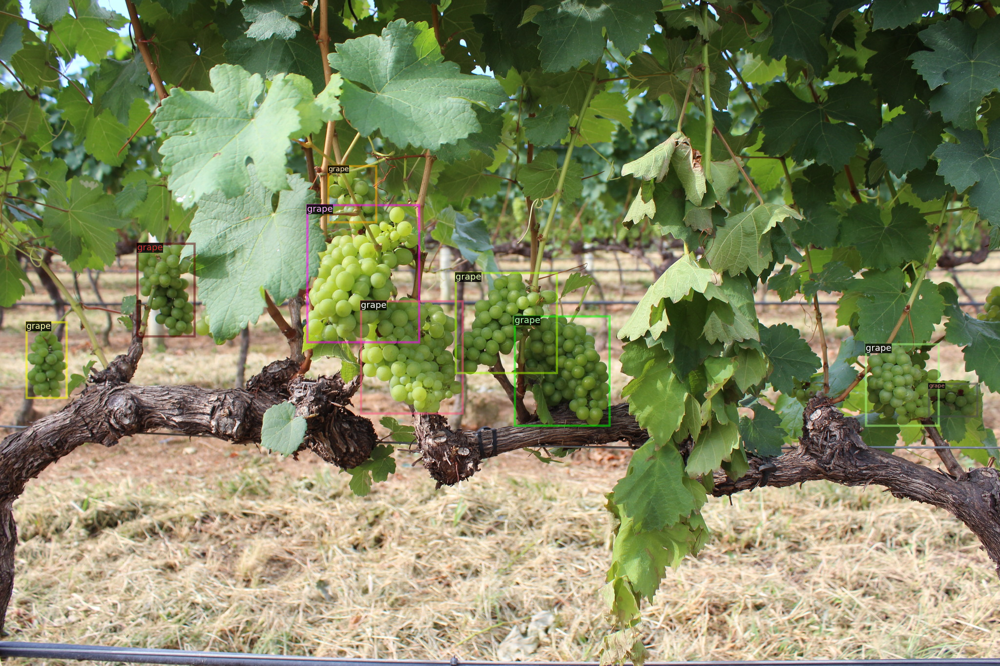

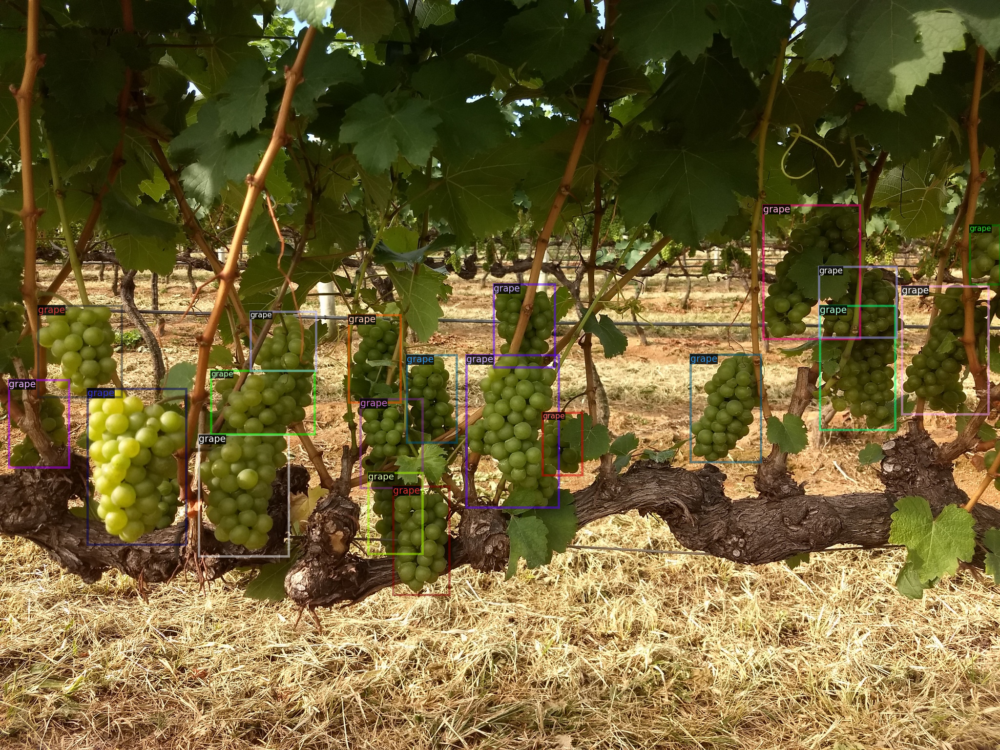

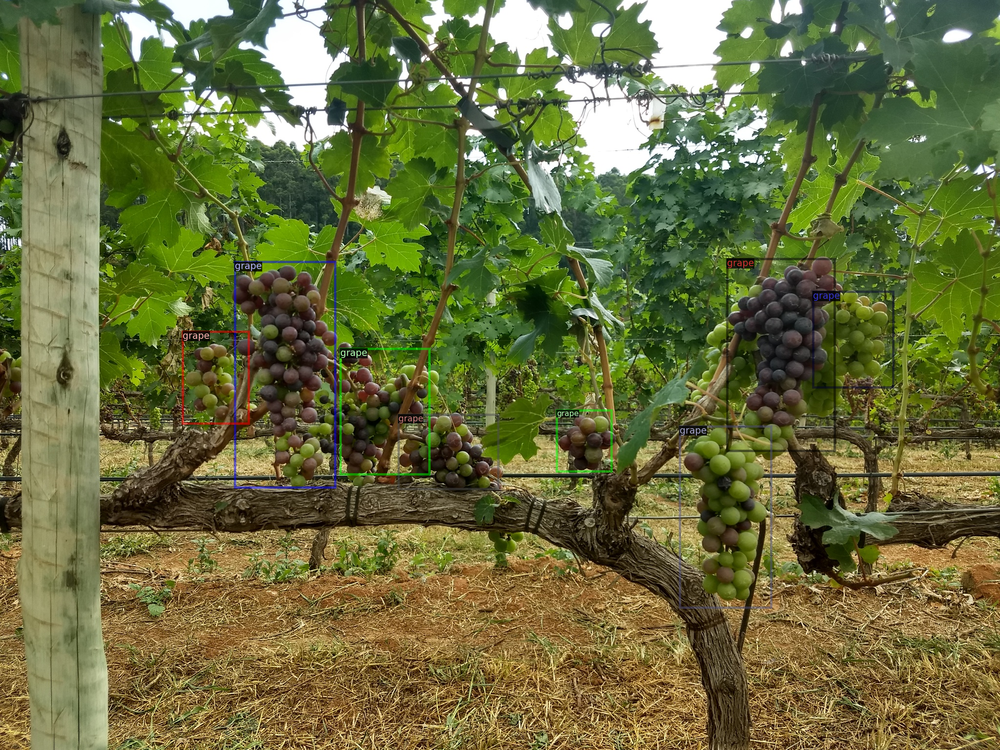

In [ ]:
from detectron2.utils.visualizer import Visualizer
import random
import cv2
from google.colab.patches import cv2_imshow

dataset_dicts = get_grapes_dict(train_images)

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(
        img[:, :, ::-1], 
        metadata=MetadataCatalog.get('grape_train'), 
        scale=1)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

# Train retinanet model.

### Create Config Object

We use retinanet model from [model zoo](https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md) as our baseline model. 

For training we will need config object. We create default config object using `get_cfg()`, then we merge [retinanet model config](COCO-Detection/retinanet_R_50_FPN_1x.yaml) into default config, load weights for retinanet model, and adjust config as per our needs.



In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
import os

"""
config file refeence
https://detectron2.readthedocs.io/en/latest/modules/config.html#config-references
"""

model_zoo_file = "COCO-Detection/retinanet_R_50_FPN_1x.yaml"

# create new config
cfg = get_cfg()

# load basic config and weights
cfg.merge_from_file(model_zoo.get_config_file(model_zoo_file))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_zoo_file)

# set one class
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 
cfg.MODEL.RETINANET.NUM_CLASSES = 1

# set datasets
cfg.DATASETS.TRAIN = ("grape_train",)
cfg.DATASETS.TEST = ("grape_val",)

# dataloaders
cfg.DATALOADER.NUM_WORKERS=2

# batch size
cfg.IMAGES_PER_BATCH_TRAIN = 2
cfg.IMAGES_PER_BATCH_TEST = 2

# solver params
cfg.SOLVER.BASE_LR = 0.0005
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.MAX_ITER = 500 # just for testing
cfg.SOLVER.STEPS = (1000, 2000, 3000)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [ ]:
print(cfg.dump())

CUDNN_BENCHMARK: false
DATALOADER:
  ASPECT_RATIO_GROUPING: true
  FILTER_EMPTY_ANNOTATIONS: true
  NUM_WORKERS: 2
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: []
  PROPOSAL_FILES_TRAIN: []
  TEST:
  - grape_val
  TRAIN:
  - grape_train
GLOBAL:
  HACK: 1.0
IMAGES_PER_BATCH_TEST: 2
IMAGES_PER_BATCH_TRAIN: 2
INPUT:
  CROP:
    ENABLED: false
    SIZE:
    - 0.9
    - 0.9
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN:
  - 640
  - 672
  - 704
  - 736
  - 768
  - 800
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES:
    - - -90
      - 0
      - 90
    ASPECT_RATIOS:
    - - 0.5
      - 1.0
      - 2.0
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES:
    - - 32
      - 40.31747359663594
      - 50.79683366298238



### Create CustomTrainer

By default detectron2 trainer does not print validation loss, it also dosen't save best model, it doesn't evaluate our model. We want to use augmentations too. To add these behaviour we need to extend detectron2 trainer and create `CustomTrainer`.

* add augmentations by overriding `build_train_loader` classmethod in `CustomTrainer`.

* add model evaluation by overriding `build_evaluator` classmethod in `CustomTrainer`

* Create `SaveBestModel` and `ValidationLoss` Hooks, by extending HookBase.

* register hooks inside `build_hooks` method of `CustomTrainer`

In [ ]:
from detectron2.data import build_detection_train_loader
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator
from detectron2.data import DatasetMapper
import detectron2.data.transforms as T
from detectron2.engine.hooks import HookBase
import torch

class SaveBestModel(HookBase):
  def __init__(self, cfg):
    self.output_dir = cfg.OUTPUT_DIR
    self.best_validation_loss = 1e10

  def before_train(self):
    self.best_validation_loss = 1e10

  def after_step(self):
    latest = trainer.storage.latest()
    if 'validation_loss' not in latest:
      return
    val_loss = latest['validation_loss'][0]
    if val_loss < self.best_validation_loss:
      self.trainer.checkpointer.save("model_best")
      self.best_validation_loss = val_loss

class ValidationLossHook(HookBase):
  def __init__(self, cfg):
    self.cfg = cfg
    self.dl = build_detection_test_loader(self.cfg, "grape_val", DatasetMapper(cfg, True))

  def after_step(self):
    with torch.no_grad():
      iter = self.trainer.iter
      final_iter = iter + 1 >= self.trainer.max_iter
      if iter % 100 == 0 or final_iter:
        total_loss = 0
        total_samples = 0
        for x in self.dl:
          loss_dict = self.trainer.model(x)
          sum_loss = sum(loss for loss in loss_dict.values())
          total_loss += sum_loss * len(x)
          total_samples += len(x)
        avg_loss = total_loss / total_samples if total_samples != 0 else 0
        self.trainer.storage.put_scalar("validation_loss", avg_loss)

class CustomTrainer(DefaultTrainer):
  @classmethod
  def build_train_loader(cls, cfg):
    mapper = DatasetMapper(cfg, is_train=True, augmentations=[
        T.Resize((800, 800)),                                                            
    ])
    return build_detection_train_loader(cfg, mapper=mapper)

  def build_hooks(self):
    hooks = super().build_hooks()
    hooks.insert(-1, ValidationLossHook(cfg))
    hooks.insert(-1, SaveBestModel(cfg))
    return hooks

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):
    if output_folder is None:
      output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
    return COCOEvaluator(dataset_name, cfg, True, output_folder)

trainer = CustomTrainer(cfg)

trainer.resume_or_load(resume=False)

trainer.train()

[03/12 12:28:07 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_bfca0b.pkl: 152MB [00:06, 24.0MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (9, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.


[03/12 12:28:15 d2.engine.train_loop]: Starting training from iteration 0
[03/12 12:28:45 d2.utils.events]:  eta: 0:07:41  iter: 19  total_loss: 1.907  loss_cls: 1.34  loss_box_reg: 0.5506  validation_loss: 1.803  time: 0.9665  data_time: 0.0252  lr: 9.9905e-06  max_mem: 1541M
[03/12 12:28:53 d2.utils.events]:  eta: 0:06:27  iter: 39  total_loss: 1.375  loss_cls: 0.979  loss_box_reg: 0.3833  validation_loss: 1.803  time: 0.6659  data_time: 0.0067  lr: 1.998e-05  max_mem: 1564M
[03/12 12:29:00 d2.utils.events]:  eta: 0:02:34  iter: 59  total_loss: 1.324  loss_cls: 0.9039  loss_box_reg: 0.4074  validation_loss: 1.803  time: 0.5551  data_time: 0.0061  lr: 2.997e-05  max_mem: 1564M
[03/12 12:29:07 d2.utils.events]:  eta: 0:02:26  iter: 79  total_loss: 1.363  loss_cls: 0.9691  loss_box_reg: 0.4132  validation_loss: 1.803  time: 0.5023  data_time: 0.0084  lr: 3.9961e-05  max_mem: 1564M
[03/12 12:29:14 d2.utils.events]:  eta: 0:02:19  iter: 99  total_loss: 1.043  loss_cls: 0.6628  loss_box_re

In [ ]:
with open('grape.yaml', 'w') as f:
  f.write(cfg.dump())

# Load best model and try it out

Use DefaultPredictor to run model, and Visualizer to visualize models output.

In [ ]:
from detectron2.engine import DefaultPredictor

score_thresh = 0.5

# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, 'model_final.pth')
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, 'model_best.pth')
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = score_thresh 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TRAIN = score_thresh
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = score_thresh 
cfg.MODEL.RETINANET.SCORE_THRESH_TRAIN = score_thresh

predictor = DefaultPredictor(cfg)

In [ ]:
import random
import cv2
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from google.colab.patches import cv2_imshow

val_dicts = get_grapes_dict(val_images)

for d in random.sample(val_dicts, 3):
  im = cv2.imread(d['file_name'])
  outputs = predictor(im)
  v = Visualizer(
      im[:, :, ::-1],
      metadata=MetadataCatalog.get("grape_val"),
  )
  out = v.draw_instance_predictions(outputs['instances'].to('cpu'))
  cv2_imshow(out.get_image()[:, :, ::-1])

Output hidden; open in https://colab.research.google.com to view.

# Export Caffe2 Model
* in caffe2 format
* in onnx format
* in torchscript format


https://detectron2.readthedocs.io/en/latest/tutorials/deployment.html

https://github.com/facebookresearch/detectron2/blob/master/tools/deploy/export_model.py

In [ ]:
from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.data import build_detection_test_loader
from detectron2.export import Caffe2Tracer, dump_torchscript_IR
from detectron2.utils.file_io import PathManager
import onnx

def export_caffe2_tracing(cfg, torch_model, inputs, format, output):
  tracer = Caffe2Tracer(cfg, torch_model, inputs)
  if format == 'caffe2':
    caffe2_model = tracer.export_caffe2()
    caffe2_model.save_protobuf(output)
    caffe2_model.save_graph(os.path.join(output, "model.svg"), inputs=inputs)
  elif format == "onnx":
    onnx_model = tracer.export_onnx()
    onnx.save(onnx_model, os.path.join(output, "model.onnx"))
  elif format == "torchscript":
    ts_model = tracer.export_torchscript()
    with PathManager.open(os.path.join(output, "model.ts"), "wb") as f:
      torch.jit.save(ts_model, f)
    dump_torchscript_IR(ts_model, output)

torch_model = build_model(cfg)
DetectionCheckpointer(torch_model).resume_or_load(cfg.MODEL.WEIGHTS)
torch_model.eval()
data_loader = build_detection_test_loader(cfg, cfg.DATASETS.TEST[0])
first_batch = next(iter(data_loader))

[03/12 12:38:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/12 12:38:49 d2.data.common]: Serializing 49 elements to byte tensors and concatenating them all ...
[03/12 12:38:49 d2.data.common]: Serialized dataset takes 0.08 MiB


In [ ]:
!mkdir model_caffe2
!mkdir model_onnx
!mkdir model_torchscript

In [ ]:
export_caffe2_tracing(cfg, torch_model, first_batch, "caffe2", "model_caffe2")

[03/12 12:33:57 d2.export.caffe2_export]: Exporting a Caffe2RetinaNet model via ONNX ... Some warnings from ONNX are expected and are usually not to worry about.


/usr/local/lib/python3.7/dist-packages/torch/onnx/utils.py:264: UserWarning: `add_node_names' can be set to True only when 'operator_export_type' is `ONNX`. Since 'operator_export_type' is not set to 'ONNX', `add_node_names` argument will be ignored.
  "`{}` argument will be ignored.".format(arg_name, arg_name))
/usr/local/lib/python3.7/dist-packages/torch/onnx/utils.py:264: UserWarning: `do_constant_folding' can be set to True only when 'operator_export_type' is `ONNX`. Since 'operator_export_type' is not set to 'ONNX', `do_constant_folding` argument will be ignored.
  "`{}` argument will be ignored.".format(arg_name, arg_name))


[03/12 12:34:08 d2.export.caffe2_export]: ONNX export Done. Exported predict_net (before optimizations):
| type          | input                                                                                               | output       |
|:--------------|:----------------------------------------------------------------------------------------------------|:-------------|
| AliasWithName | ['data']                                                                                            | ['308']      |
| AliasWithName | ['im_info']                                                                                         | ['309']      |
| Cast          | ['308']                                                                                             | ['310']      |
| Sub           | ['310', '311']                                                                                      | ['312']      |
| Div           | ['312', '313']                                                     

In [ ]:
export_caffe2_tracing(cfg, torch_model, first_batch, "onnx", "model_onnx")

/usr/local/lib/python3.7/dist-packages/torch/onnx/utils.py:264: UserWarning: `add_node_names' can be set to True only when 'operator_export_type' is `ONNX`. Since 'operator_export_type' is not set to 'ONNX', `add_node_names` argument will be ignored.
  "`{}` argument will be ignored.".format(arg_name, arg_name))
/usr/local/lib/python3.7/dist-packages/torch/onnx/utils.py:264: UserWarning: `do_constant_folding' can be set to True only when 'operator_export_type' is `ONNX`. Since 'operator_export_type' is not set to 'ONNX', `do_constant_folding` argument will be ignored.
  "`{}` argument will be ignored.".format(arg_name, arg_name))


In [ ]:
export_caffe2_tracing(cfg, torch_model, first_batch, "torchscript", "model_torchscript")

[03/12 12:38:53 d2.export.api]: Tracing the model with torch.jit.trace ...


In [ ]:
!ls -lh ./model_caffe2 ./model_onnx ./model_torchscript

./model_caffe2:
total 174M
-rw-r--r-- 1 root root 174M Mar 12 12:34 model_init.pb
-rw-r--r-- 1 root root  25K Mar 12 12:34 model.pb
-rw-r--r-- 1 root root  79K Mar 12 12:34 model.pbtxt
-rw-r--r-- 1 root root 599K Mar 12 12:34 model.svg

./model_onnx:
total 139M
-rw-r--r-- 1 root root 139M Mar 12 12:38 model.onnx

./model_torchscript:
total 141M
-rw-r--r-- 1 root root 140M Mar 12 12:38 model.ts
-rw-r--r-- 1 root root 138K Mar 12 12:38 model_ts_code.txt
-rw-r--r-- 1 root root 262K Mar 12 12:38 model_ts_IR_inlined.txt
-rw-r--r-- 1 root root 1.5M Mar 12 12:38 model_ts_IR.txt
-rw-r--r-- 1 root root  12K Mar 12 12:38 model.txt
